In [48]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from matplotlib import style
from glob import glob
from natsort import natsorted
from tqdm import tqdm
style.use('ggplot')
from src.Jinil import homographies
from src.Jinil import utils

In [49]:
gt_images = []
for files in tqdm(natsorted(glob('Images/I1/*'))):
    gt_images.append(cv2.imread(files, 1))

gt_images = np.array(gt_images)

  0%|          | 0/6 [00:00<?, ?it/s]

100%|██████████| 6/6 [00:00<00:00, 11.46it/s]


In [50]:
def show_image_grid(images, M, N, title='Title', is_gray=False, figsize=None):
    """
    Display a grid of images.

    Args:
    - images: A numpy array of shape (num_images, height, width[, channels]).
    - M: Number of rows in the grid.
    - N: Number of columns in the grid.
    - title: Title for the grid.
    - is_gray: Flag to indicate whether the images are grayscale (True) or RGB (False).
    - figsize: Tuple specifying the figure size (width, height). If None, it is automatically calculated based on the image shape.
    """
    # Determine the default figsize based on image dimensions
    if figsize is None:
        if len(images.shape) == 4 or (len(images.shape) == 3 and is_gray):
            img_height, img_width = images.shape[1], images.shape[2]
        else:
            raise ValueError("Invalid image shape. Expected shape (num_images, height, width[, channels]).")
        
        aspect_ratio = img_width / img_height
        figsize = (N * aspect_ratio * 5, M * 5)  # Scale width by aspect ratio

    fig, axes = plt.subplots(M, N, figsize=figsize)

    # Add batch dimension if missing
    if len(images.shape) < 4 and not is_gray:
        images = np.expand_dims(images.copy(), axis=0)

    fig.suptitle(title)
    for i in range(M):
        for j in range(N):
            if M == 1 and N == 1:
                ax = axes
            elif M == 1 or N == 1:
                ax = axes[max(i, j)]
            else:
                ax = axes[i, j]
            index = i * N + j
            if index < images.shape[0]:
                if is_gray:
                    ax.imshow(images[index], cmap='gray')
                else:
                    ax.imshow(cv2.cvtColor(images[index], cv2.COLOR_BGR2RGB))
            ax.axis('off')
    plt.tight_layout()
    plt.show()


### Stitching image 1 and 2

In [51]:
H12 = homographies.estimate_homography(gt_images[0], gt_images[1])

sift_matrix12, size12 = utils.shift_matrix_left_size(gt_images[0], gt_images[1], H12)

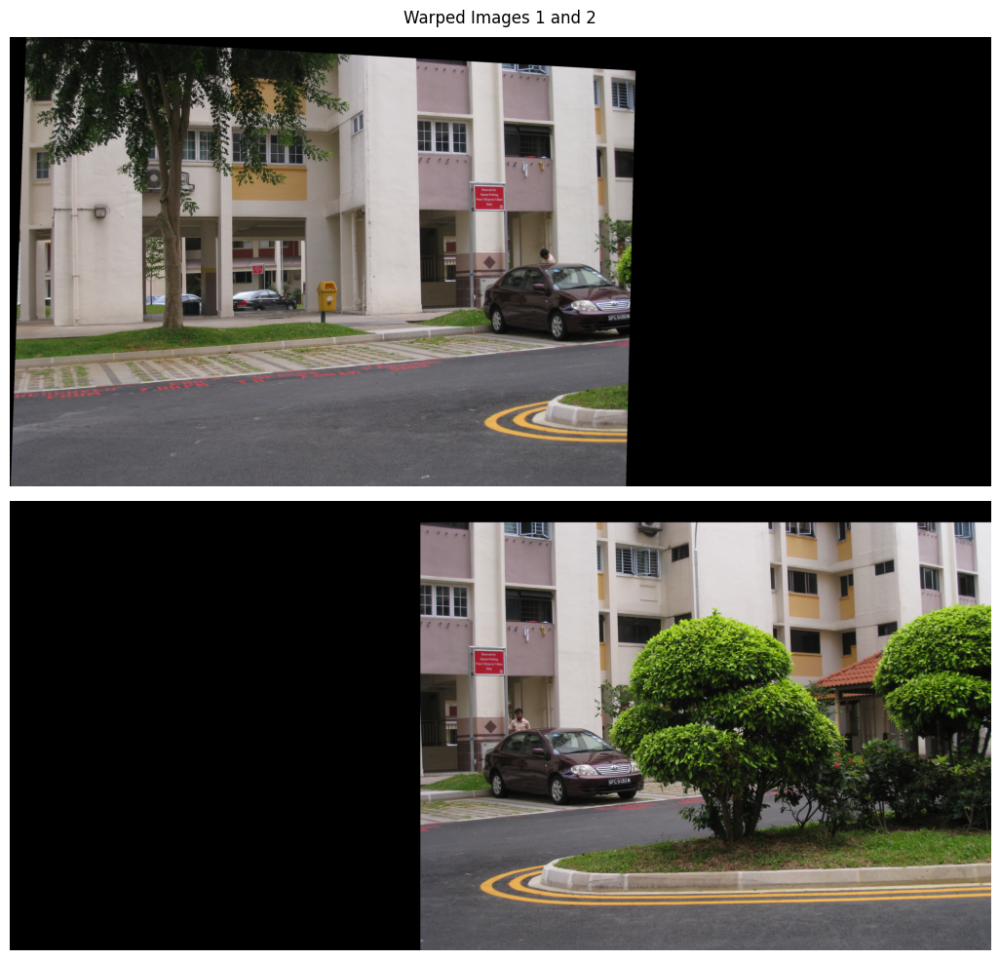

In [52]:
warped_img1 = utils.warp_perpective(gt_images[0], sift_matrix12 @ H12, size12)
warped_img2 = utils.warp_perpective(gt_images[1], sift_matrix12, size12)

show_image_grid(np.array([warped_img1, warped_img2]), 2, 1, 'Warped Images 1 and 2', is_gray=False)

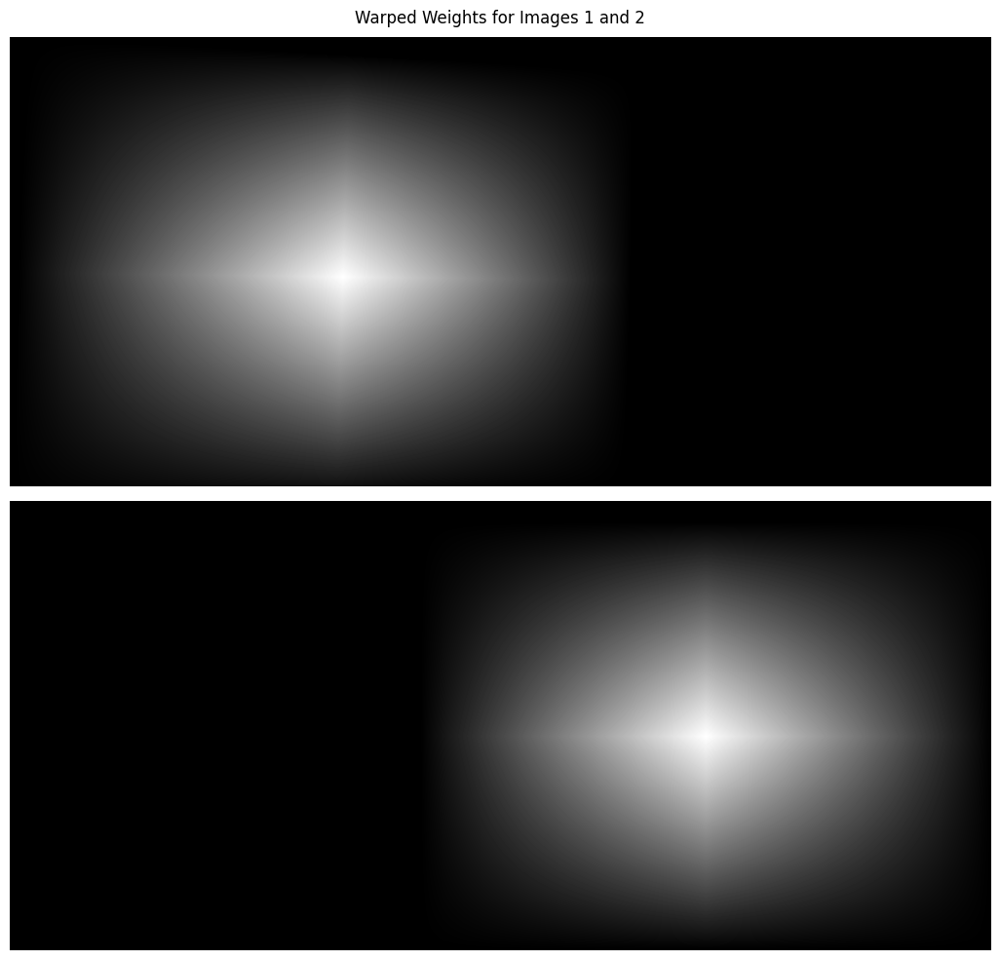

In [53]:
warped_img1_weight = utils.blending_weight(gt_images[0], sift_matrix12 @ H12, size12)
warped_img2_weight = utils.blending_weight(gt_images[0], sift_matrix12, size12)

show_image_grid(np.array([warped_img1_weight, warped_img2_weight]), 2, 1, 'Warped Weights for Images 1 and 2', is_gray=True)

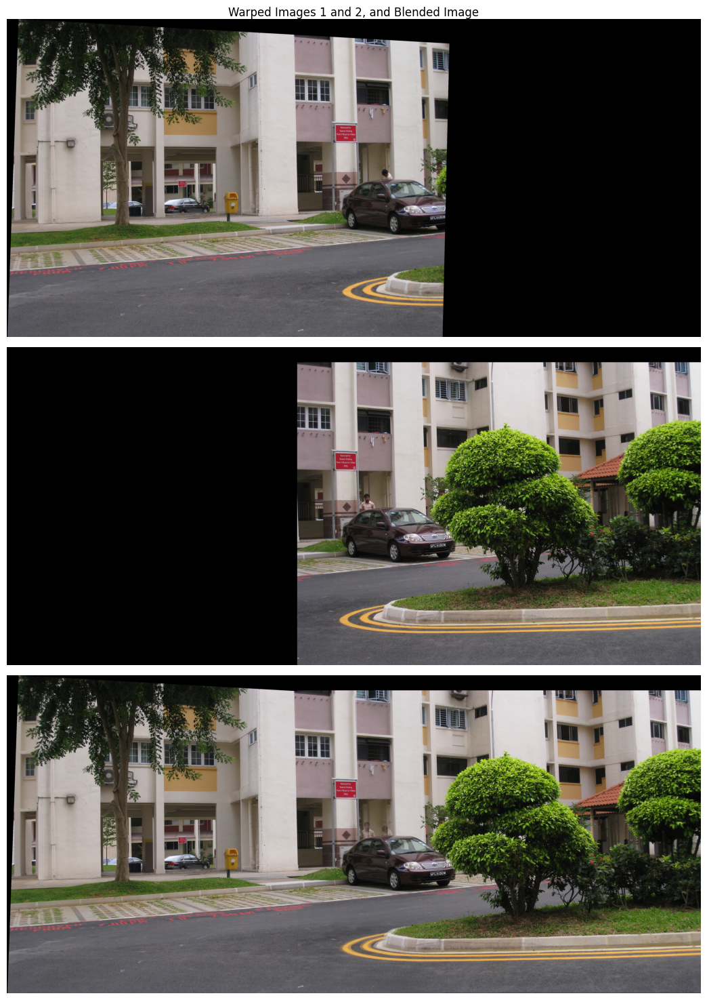

In [54]:
warped_img1_weight_norm, warped_img2_weight_norm, total_weight12 = utils.normalize_weights(warped_img1_weight, warped_img2_weight)

warped_img1_weight_3d = np.repeat(warped_img1_weight_norm[:, :, np.newaxis], 3, axis=2)
warped_img2_weight_3d = np.repeat(warped_img2_weight_norm[:, :, np.newaxis], 3, axis=2)
total_weight12_3d = np.repeat(total_weight12[:, :, np.newaxis], 3, axis=2)

img12 = np.clip(warped_img1_weight_3d * warped_img1.astype(np.float32) + warped_img2_weight_3d * warped_img2.astype(np.float32), 0, 255).astype(np.uint8)

show_image_grid(np.array([warped_img1, warped_img2, img12]), 3, 1, 'Warped Images 1 and 2, and Blended Image', is_gray=False)

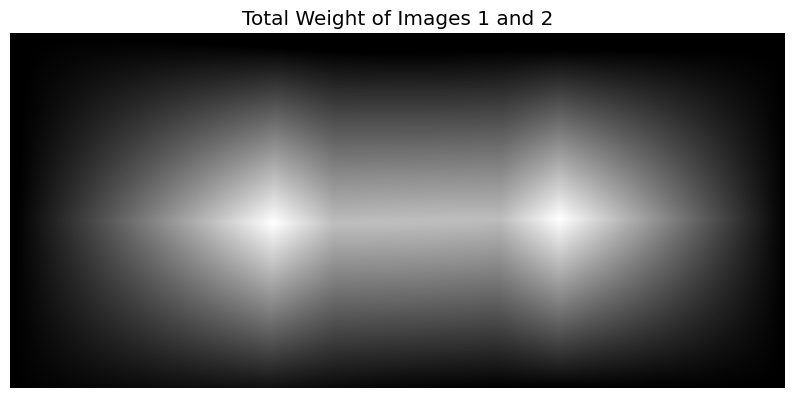

In [73]:
plt.figure(figsize=(10, 10))
plt.imshow(total_weight12, cmap='gray')
plt.title('Total Weight of Images 1 and 2')
plt.axis('off')
plt.show()

### Blending image 3 with 12

In [55]:
H23 = homographies.estimate_homography(gt_images[1], gt_images[2])

In [56]:
sift12_3, size12_3 = utils.shift_matrix_left_size(img12, gt_images[2], H23 @ np.linalg.inv(sift_matrix12))

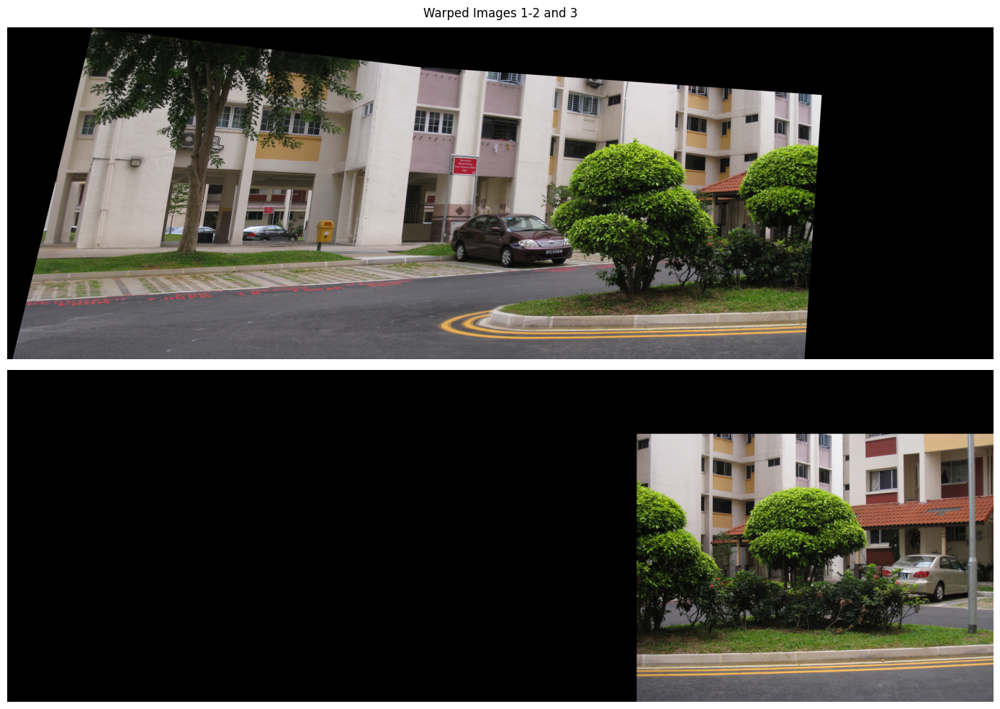

In [57]:
warped_img12 = utils.warp_perpective(img12, sift12_3 @ H23 @ np.linalg.inv(sift_matrix12), size12_3)
warped_img3 = utils.warp_perpective(gt_images[2], sift12_3, size12_3)

show_image_grid(np.array([warped_img12, warped_img3]), 2, 1, 'Warped Images 1-2 and 3', is_gray=False)

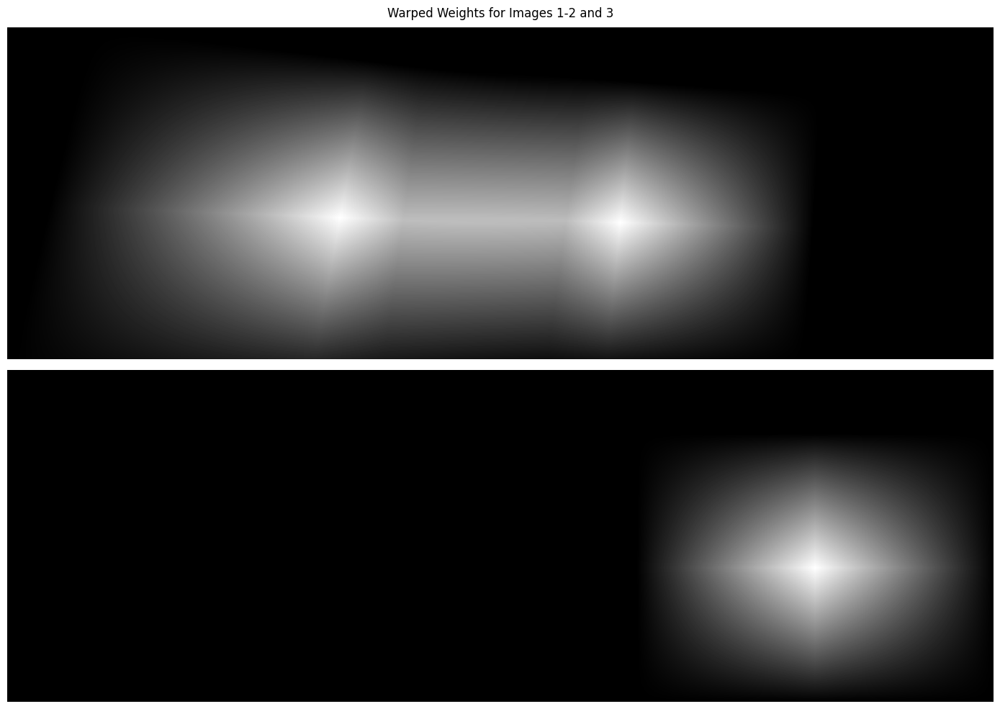

In [58]:
warped_img12_weight = cv2.warpPerspective(total_weight12, sift12_3 @ H23 @ np.linalg.inv(sift_matrix12), size12_3)
warped_img3_weight = utils.blending_weight(gt_images[2], sift12_3, size12_3)

show_image_grid(np.array([warped_img12_weight, warped_img3_weight]), 2, 1, 'Warped Weights for Images 1-2 and 3', is_gray=True)


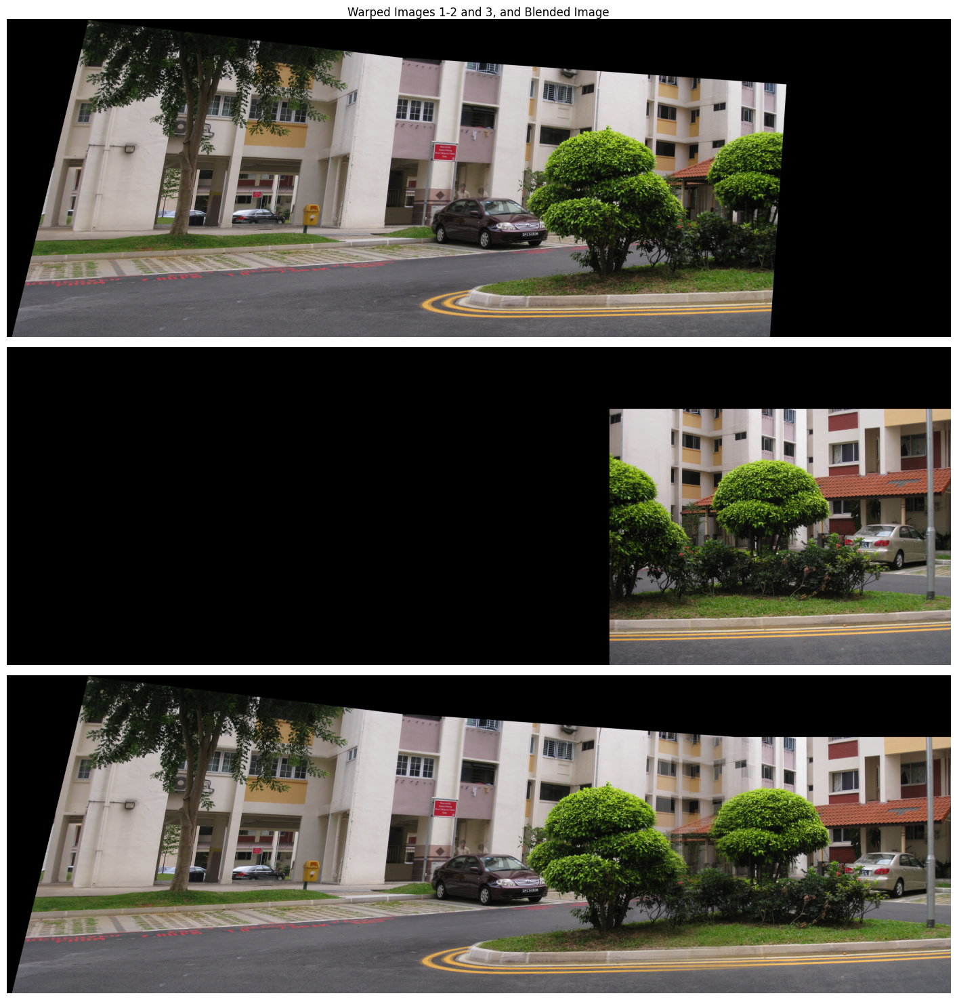

In [59]:
warped_img12_weight_norm, warped_img3_weight_norm, total_weight12_3 = utils.normalize_weights(warped_img12_weight, warped_img3_weight)

warped_img12_weight_3d = np.repeat(warped_img12_weight_norm[:, :, np.newaxis], 3, axis=2)
warped_img3_weight_3d = np.repeat(warped_img3_weight_norm[:, :, np.newaxis], 3, axis=2)

img123 = np.clip(warped_img12_weight_3d * warped_img12.astype(np.float32) + warped_img3_weight_3d * warped_img3.astype(np.float32), 0, 255).astype(np.uint8)

show_image_grid(np.array([warped_img12, warped_img3, img123]), 3, 1, 'Warped Images 1-2 and 3, and Blended Image', is_gray=False)

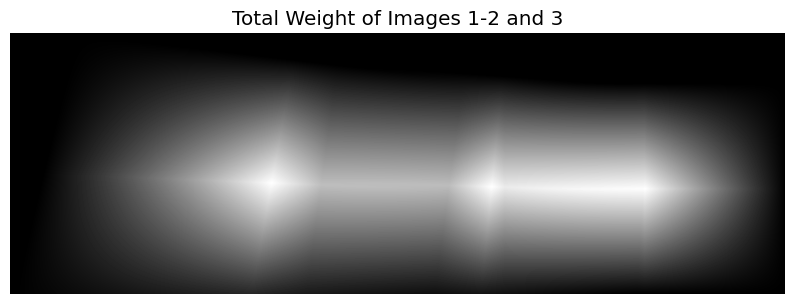

In [74]:
plt.figure(figsize=(10, 10))
plt.imshow(total_weight12_3, cmap='gray')
plt.title('Total Weight of Images 1-2 and 3')
plt.axis('off')
plt.show()

### Blending image 6 with 5

In [60]:
H65 = homographies.estimate_homography(gt_images[5], gt_images[4])

sift65, size65 = utils.shift_matrix_right_size(gt_images[5], gt_images[4], H65)

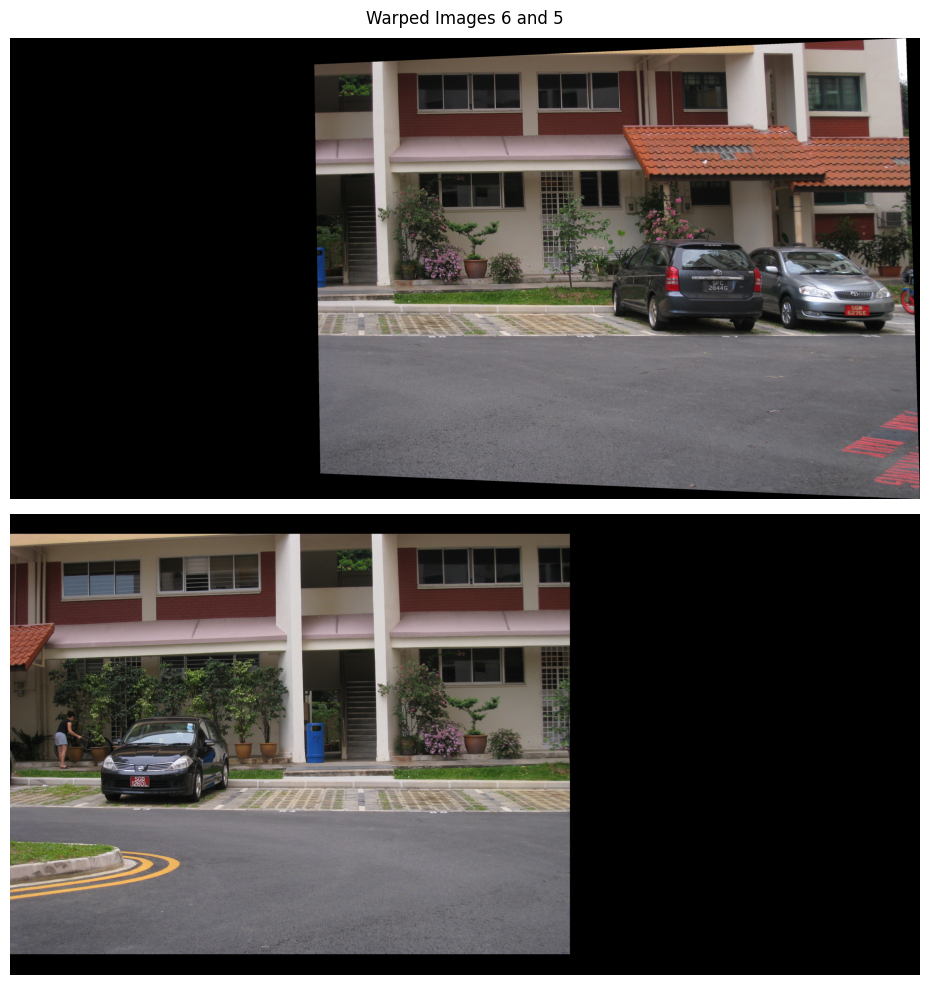

In [61]:
warped_img6 = utils.warp_perpective(gt_images[5], sift65 @ H65, size65)
warped_img5 = utils.warp_perpective(gt_images[4], sift65, size65)

show_image_grid(np.array([warped_img6, warped_img5]), 2, 1, 'Warped Images 6 and 5', is_gray=False)

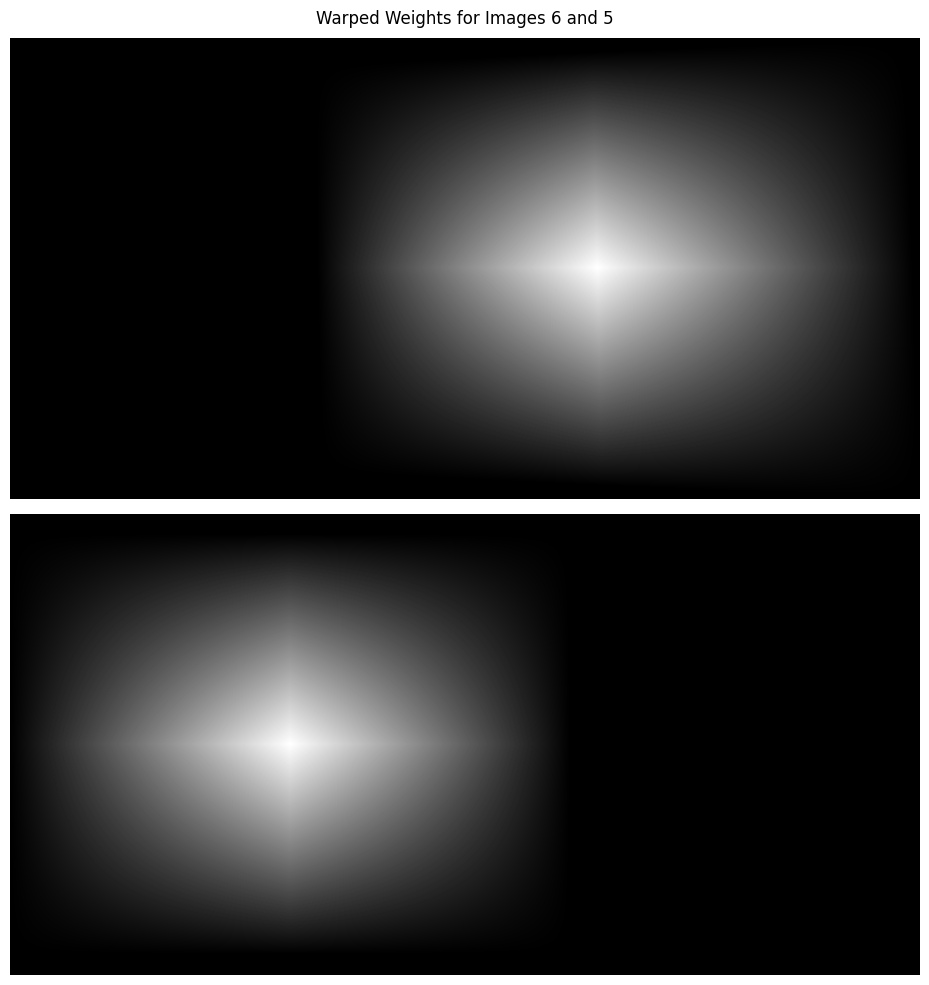

In [62]:
warped_img6_weight = utils.blending_weight(gt_images[5], sift65 @ H65, size65)
warped_img5_weight = utils.blending_weight(gt_images[4], sift65, size65)

show_image_grid(np.array([warped_img6_weight, warped_img5_weight]), 2, 1, 'Warped Weights for Images 6 and 5', is_gray=True)

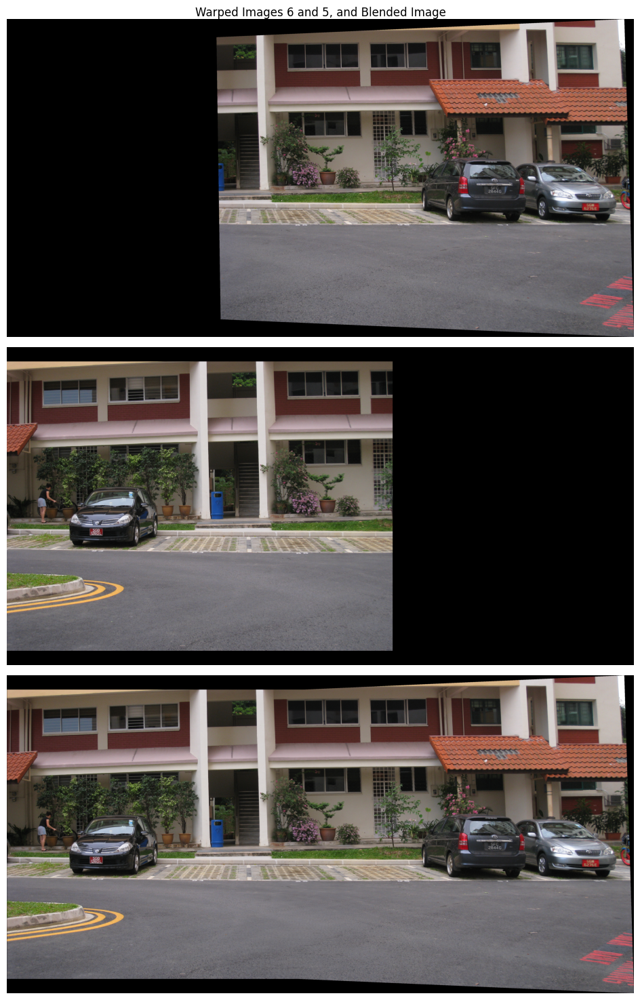

In [63]:
warped_img6_weight_norm, warped_img5_weight_norm, total_weight65 = utils.normalize_weights(warped_img6_weight, warped_img5_weight)

warped_img6_weight_3d = np.repeat(warped_img6_weight_norm[:, :, np.newaxis], 3, axis=2)
warped_img5_weight_3d = np.repeat(warped_img5_weight_norm[:, :, np.newaxis], 3, axis=2)

img65 = np.clip(warped_img6_weight_3d * warped_img6.astype(np.float32) + warped_img5_weight_3d * warped_img5.astype(np.float32), 0, 255).astype(np.uint8)

show_image_grid(np.array([warped_img6, warped_img5, img65]), 3, 1, 'Warped Images 6 and 5, and Blended Image', is_gray=False)

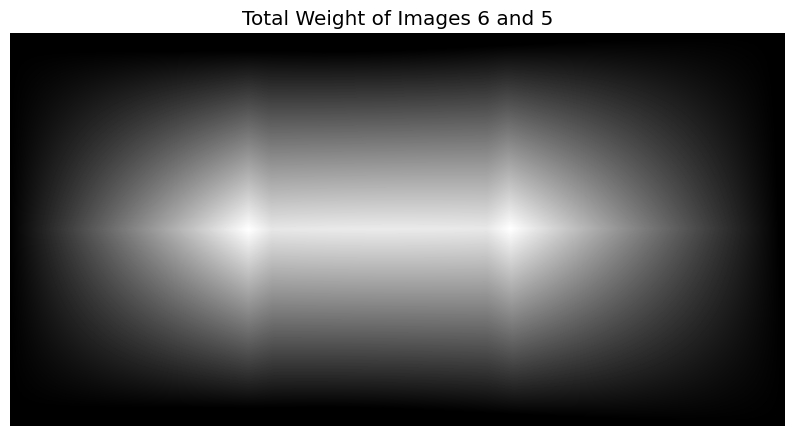

In [75]:
plt.figure(figsize=(10, 10))
plt.imshow(total_weight65, cmap='gray')
plt.title('Total Weight of Images 6 and 5')
plt.axis('off')
plt.show()

### Blending image 4 with 56

In [64]:
H54 = homographies.estimate_homography(gt_images[4], gt_images[3])
sift65_4, size65_4 = utils.shift_matrix_right_size(img65, gt_images[3], H54 @ np.linalg.inv(sift65))

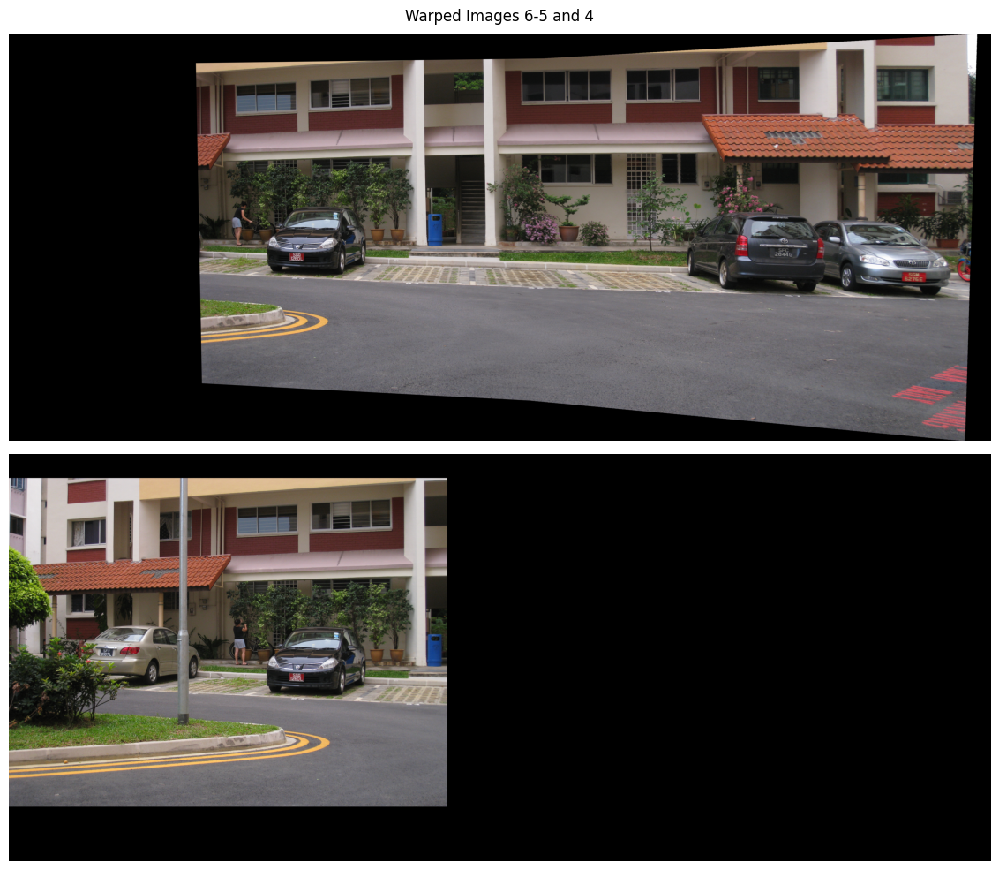

In [65]:
warped_img65 = utils.warp_perpective(img65, sift65_4 @ H54 @ np.linalg.inv(sift65), size65_4)
warped_img4 = utils.warp_perpective(gt_images[3], sift65_4, size65_4)

show_image_grid(np.array([warped_img65, warped_img4]), 2, 1, 'Warped Images 6-5 and 4', is_gray=False)

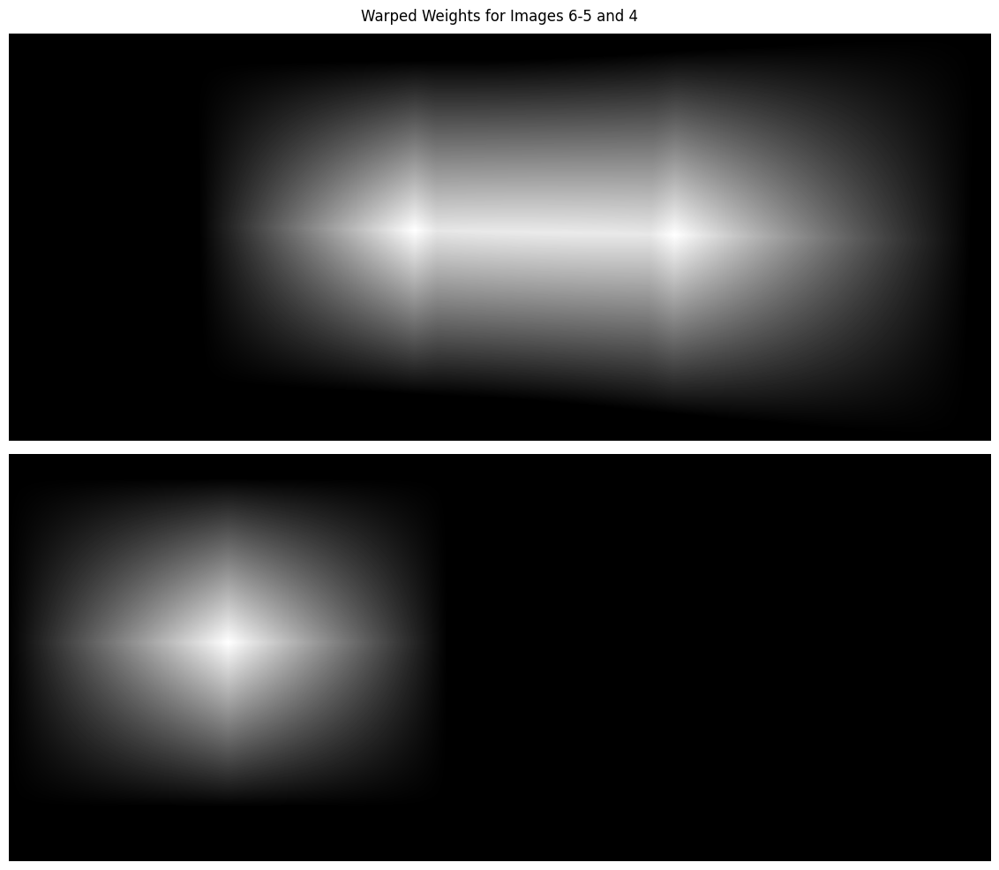

In [66]:
warped_img65_weight = cv2.warpPerspective(total_weight65, sift65_4 @ H54 @ np.linalg.inv(sift65), size65_4)
warped_img4_weight = utils.blending_weight(gt_images[3], sift65_4.astype(np.float32), size65_4)

show_image_grid(np.array([warped_img65_weight, warped_img4_weight]), 2, 1, 'Warped Weights for Images 6-5 and 4', is_gray=True)

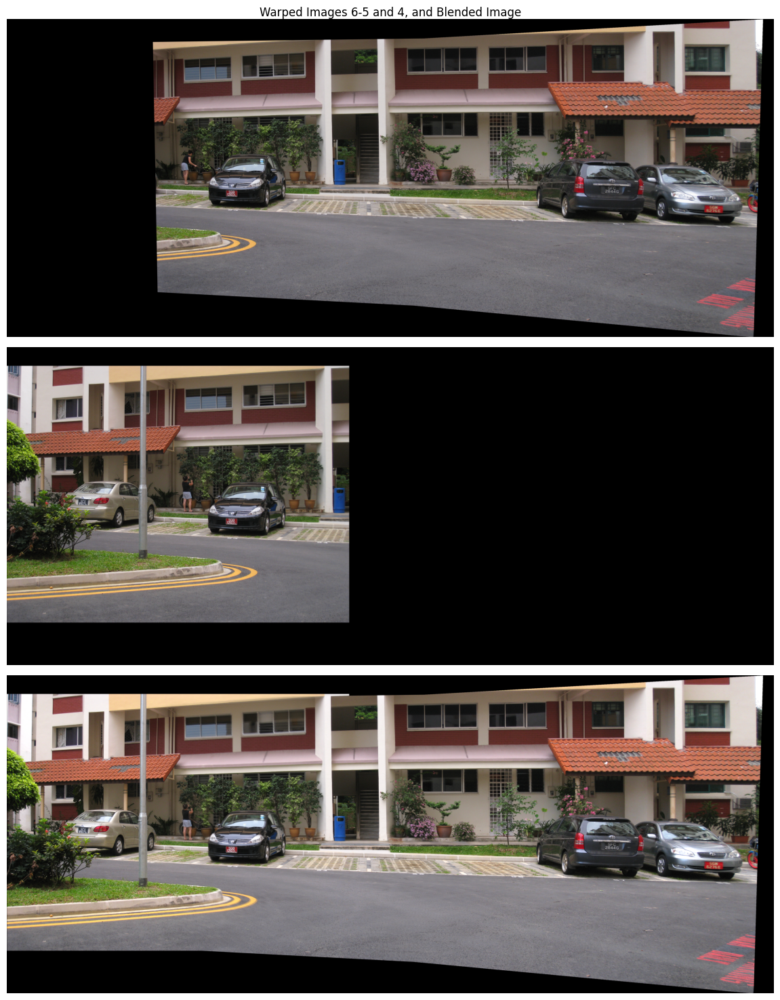

In [67]:
warped_img65_weight_norm, warped_img4_weight_norm, total_weight65_4 = utils.normalize_weights(warped_img65_weight, warped_img4_weight)

warped_img65_weight_3d = np.repeat(warped_img65_weight_norm[:, :, np.newaxis], 3, axis=2)
warped_img4_weight_3d = np.repeat(warped_img4_weight_norm[:, :, np.newaxis], 3, axis=2)

img654 = np.clip(warped_img65_weight_3d.astype(np.float32) * warped_img65.astype(np.float32) + warped_img4_weight_3d.astype(np.float32) * warped_img4.astype(np.float32), 0, 255).astype(np.uint8)

show_image_grid(np.array([warped_img65, warped_img4, img654]), 3, 1, 'Warped Images 6-5 and 4, and Blended Image', is_gray=False)

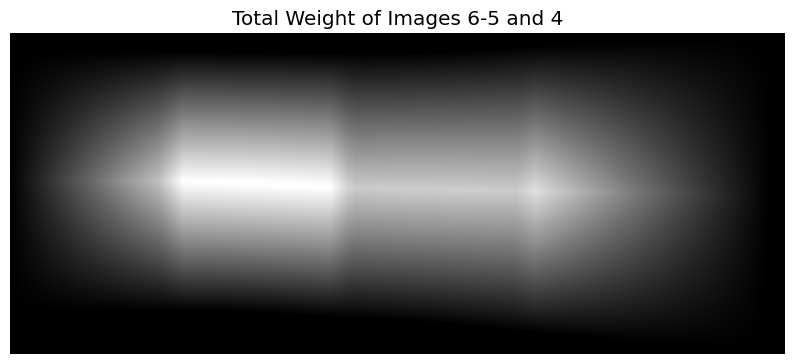

In [76]:
plt.figure(figsize=(10, 10))
plt.imshow(total_weight65_4, cmap='gray')
plt.title('Total Weight of Images 6-5 and 4')
plt.axis('off')
plt.show()

### Warping of img123 with img456

In [68]:
H = homographies.estimate_homography(gt_images[3], gt_images[2])
corners, min_x, min_y, max_x, max_y = utils.transform_corners(img654, H @ np.linalg.inv(sift65_4))
corners1, min_x1, min_y1, max_x1, max_y1 = utils.transform_corners(img123, np.linalg.inv(sift12_3))

final_canvas_width = int(max_x - min_x1)
final_canvas_height = int(max(max_y, max_y1) - min(min_y, min_y1))

canvas_size_123_654 = (final_canvas_width, final_canvas_height)
sift_123_654 = np.array([[1, 0, -min_x1], [0, 1, -min(min_y, min_y1)], [0, 0, 1]])


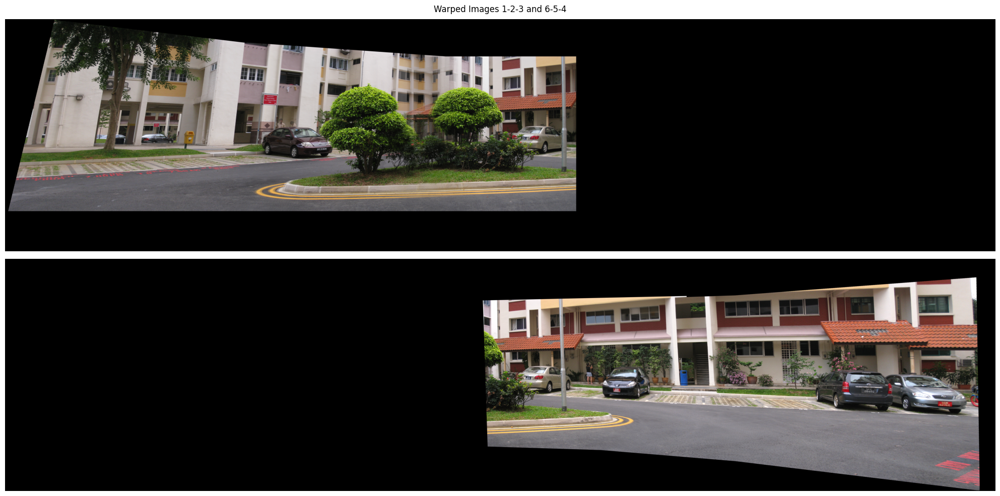

In [69]:
warped_img123 = utils.warp_perpective(img123, sift_123_654 @ np.linalg.inv(sift12_3), canvas_size_123_654)
warped_img654 = utils.warp_perpective(img654, sift_123_654 @ H @ np.linalg.inv(sift65_4), canvas_size_123_654)

show_image_grid(np.array([warped_img123, warped_img654]), 2, 1, 'Warped Images 1-2-3 and 6-5-4', is_gray=False)

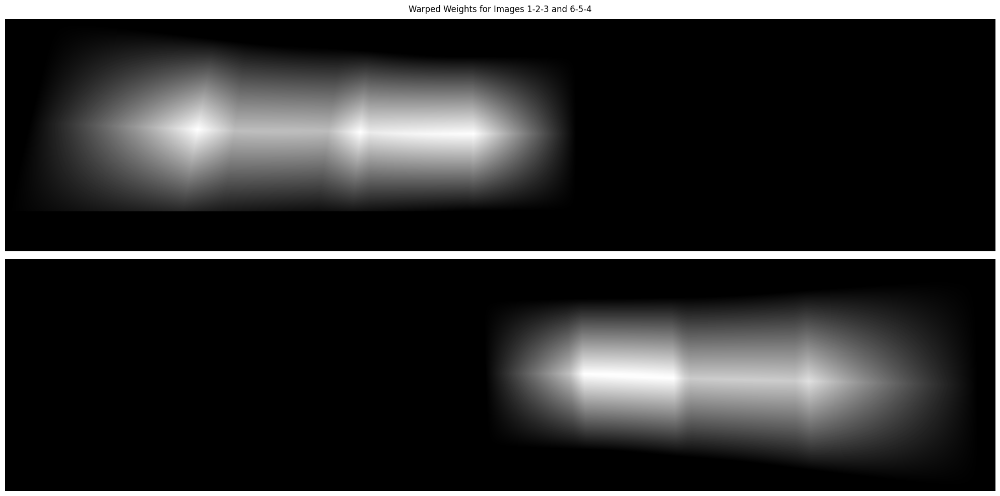

In [70]:
warped_img123_weight = cv2.warpPerspective(total_weight12_3, sift_123_654 @ np.linalg.inv(sift12_3), canvas_size_123_654)
warped_img654_weight = cv2.warpPerspective(total_weight65_4, sift_123_654 @ H @ np.linalg.inv(sift65_4), canvas_size_123_654)

show_image_grid(np.array([warped_img123_weight, warped_img654_weight]), 2, 1, 'Warped Weights for Images 1-2-3 and 6-5-4', is_gray=True)

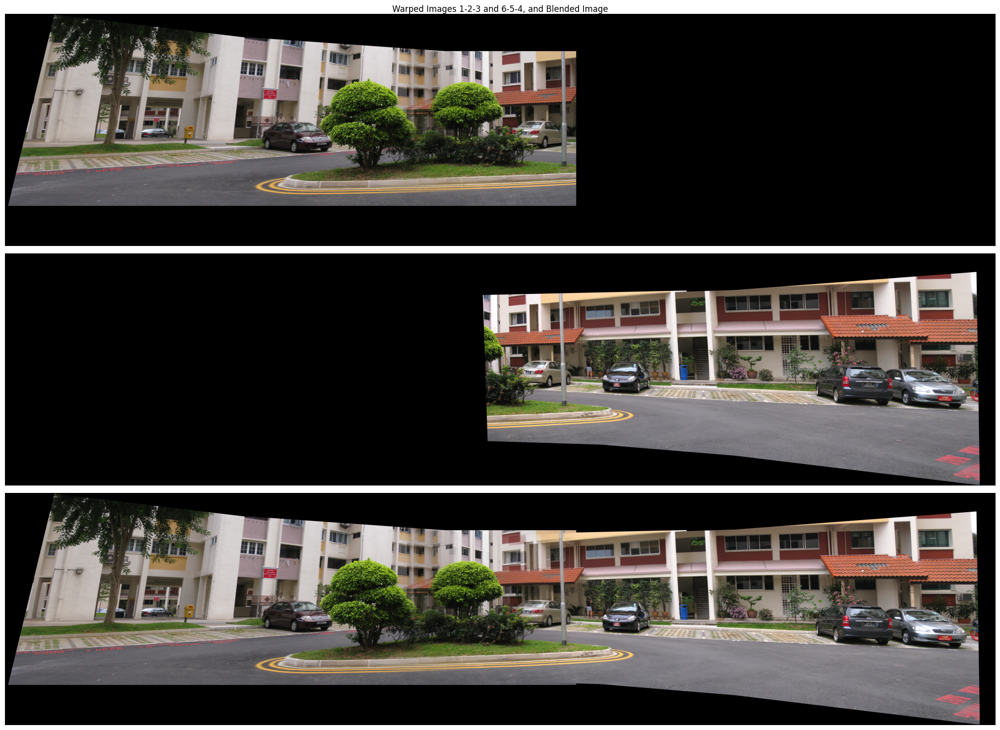

In [71]:
warped_img123_weight_norm, warped_img654_weight_norm, total_weight123_654 = utils.normalize_weights(warped_img123_weight, warped_img654_weight)

warped_img123_weight_3d = np.repeat(warped_img123_weight_norm[:, :, np.newaxis], 3, axis=2)
warped_img654_weight_3d = np.repeat(warped_img654_weight_norm[:, :, np.newaxis], 3, axis=2)

final_image = np.clip(warped_img123_weight_3d * warped_img123.astype(np.float32) + warped_img654_weight_3d * warped_img654.astype(np.float32), 0, 255).astype(np.uint8)

show_image_grid(np.array([warped_img123, warped_img654, final_image]), 3, 1, 'Warped Images 1-2-3 and 6-5-4, and Blended Image', is_gray=False)

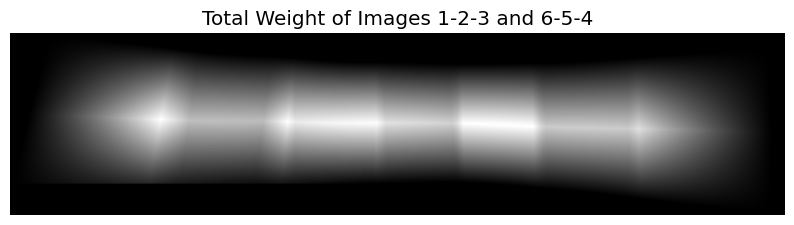

In [72]:
plt.figure(figsize=(10, 10))
plt.imshow(total_weight123_654, cmap='gray')
plt.title('Total Weight of Images 1-2-3 and 6-5-4')
plt.axis('off')
plt.show()